In [1]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import re
import datetime as dt
import pandas_profiling as pp
import numpy as np
%matplotlib inline
plt.show()

In [2]:
# Importing the csv
df= pd.read_csv('fidelity_mutual_funds_return_w_risk.csv')
df.head()

,name,morningstar_category,ytdDaily,yr1,yr3,yr5,yr10,life_of_fund,net_expense_ratio,gross_expense_ratio,morningstar_rating_overall,risk,std_dev,sharpe_ratio_3_yr,beta,r2,minimum_investment,last_dividend
0,Baron Partners Fund Institutional Shares (BPTIX),Large Growth,44.60,110.27,65.56,47.54,29.02,27.02,1.30,1.30,1137.0,6,40.41,1.60,1.51,0.63,1000000.0,0.2224
1,Baron Partners Fund Retail Shares (BPTRX),Large Growth,44.28,109.72,65.13,47.15,28.68,20.45,1.56,1.56,1137.0,6,40.39,1.59,1.51,0.63,2500.0,0.1243
2,"Morgan Stanley Institutional Fund, Inc. Incept...",Small Growth,20.05,81.15,55.11,38.37,22.37,14.14,1.00,1.19,574.0,7,40.44,1.34,1.40,0.71,5000000.0,0.0000
3,"Morgan Stanley Institutional Fund, Inc. Incept...",Small Growth,19.75,80.67,54.70,37.98,22.01,13.83,1.35,1.45,574.0,7,40.48,1.32,1.40,0.71,2500.0,0.0000
4,"Morgan Stanley Institutional Fund, Inc. Incept...",Small Growth,NaN,79.39,53.46,36.90,21.11,13.00,2.10,2.27,574.0,7,40.42,1.30,1.40,0.71,2500.0,NaN


In [3]:
# dataset structure
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9626 entries, 0 to 9625
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   name                        9626 non-null   object 
 1   morningstar_category        9626 non-null   object 
 2   ytdDaily                    9359 non-null   float64
 3   yr1                         9520 non-null   float64
 4   yr3                         9204 non-null   float64
 5   yr5                         8922 non-null   float64
 6   yr10                        7283 non-null   float64
 7   life_of_fund                9613 non-null   float64
 8   net_expense_ratio           9625 non-null   float64
 9   gross_expense_ratio         9624 non-null   float64
 10  morningstar_rating_overall  9102 non-null   float64
 11  risk                        9626 non-null   int64  
 12  std_dev                     9154 non-null   float64
 13  sharpe_ratio_3_yr           9154 

In [4]:
# 5 number summary
df.describe()

,ytdDaily,yr1,yr3,yr5,yr10,life_of_fund,net_expense_ratio,gross_expense_ratio,morningstar_rating_overall,risk,std_dev,sharpe_ratio_3_yr,beta,r2,minimum_investment,last_dividend
count,9359.000000,9520.000000,9204.000000,8922.000000,7283.000000,9613.000000,9625.000000,9624.000000,9102.000000,9626.000000,9154.000000,9154.000000,8189.000000,8189.000000,9.624000e+03,9178.000000
mean,12.841688,25.532315,12.170789,9.872851,8.455235,7.796146,1.154081,1.412057,464.152604,5.271556,14.547154,0.784549,0.788115,0.805881,2.455934e+05,0.116582
std,12.137653,20.381654,8.276280,7.080595,5.485703,5.245337,0.570965,1.333127,362.456368,1.665109,8.134948,0.391578,1.218248,0.282312,8.381462e+05,0.499280
min,-22.090000,-37.660000,-29.380000,-23.430000,-19.020000,-11.740000,0.000000,0.000000,10.000000,0.000000,0.180000,-2.450000,-21.000000,0.000000,0.000000e+00,0.000000
25%,1.890000,6.010000,5.460000,3.740000,3.760000,4.650000,0.760000,0.850000,186.000000,4.000000,7.192500,0.550000,0.820000,0.810000,2.500000e+03,0.013883
50%,11.970000,26.135000,11.265000,9.120000,8.180000,7.080000,1.050000,1.190000,361.000000,6.000000,16.080000,0.780000,0.960000,0.930000,2.500000e+03,0.034480
75%,22.070000,40.180000,16.950000,14.160000,12.530000,10.170000,1.490000,1.700000,631.000000,6.000000,19.870000,1.030000,1.050000,0.970000,5.000000e+03,0.118995
max,83.850000,146.460000,65.560000,47.540000,29.020000,82.450000,5.250000,46.990000,1250.000000,9.000000,59.740000,2.610000,8.750000,1.000000,1.000000e+07,24.012771


# Data Profiling

In [17]:
# Perform data profiling
profile_report = pp.ProfileReport(df)
profile_report.to_file("fidelity_funds_profiling.html")
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Pair plot

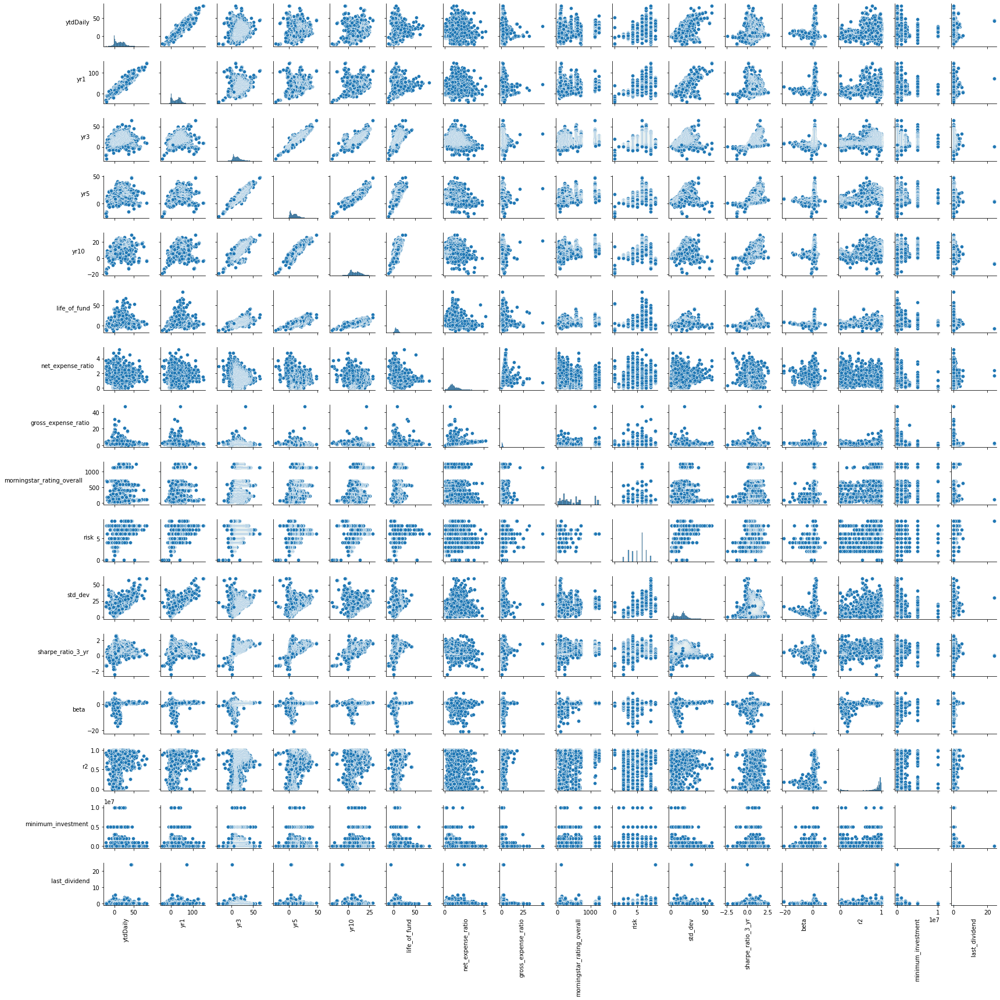

In [91]:
# Create the default pairplot using seaborn
g =sns.pairplot(df, height =1.5)
for ax in g.axes.flat:
    # rotate x axis labels
    ax.set_xlabel(ax.get_xlabel(), rotation = 90)
    # rotate y axis labels
    ax.set_ylabel(ax.get_ylabel(), rotation = 0)
    # set y labels alignment
    ax.yaxis.get_label().set_horizontalalignment('right')
plt.tight_layout()
plt.savefig('pairplot_all.png', facecolor='w')
plt.show()

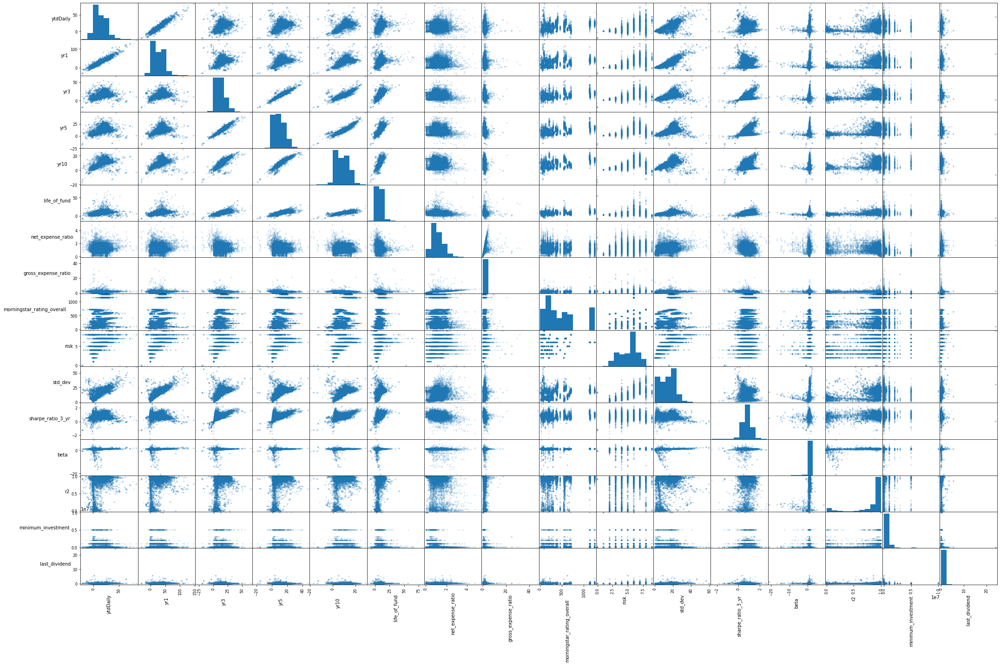

In [48]:
# Create the default scatter matrix using pandas
axes = pd.plotting.scatter_matrix(df, alpha=0.2,figsize=(30, 20))

for ax in axes.flatten():
    ax.xaxis.label.set_rotation(90)
    ax.yaxis.label.set_rotation(0)
    ax.yaxis.label.set_ha('right')

plt.tight_layout()
plt.gcf().subplots_adjust(wspace=0, hspace=0)
plt.savefig('pandas_scatter_matrix.png', facecolor='w')
plt.show()

# Box Plot of returns

<AxesSubplot:>

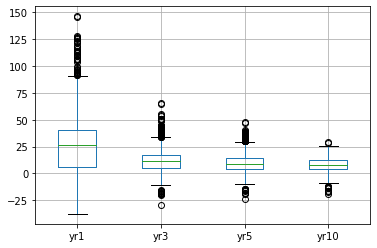

In [10]:
df.boxplot(['yr1', 'yr3', 'yr5', 'yr10'])

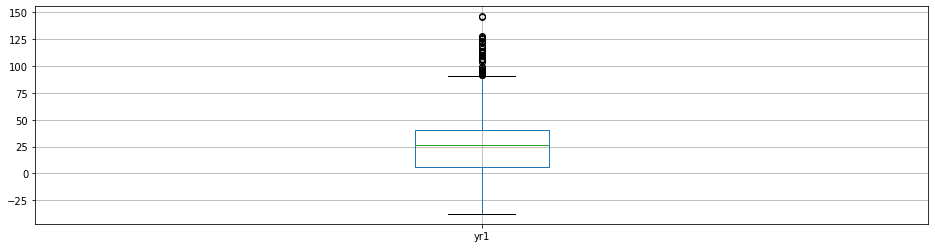

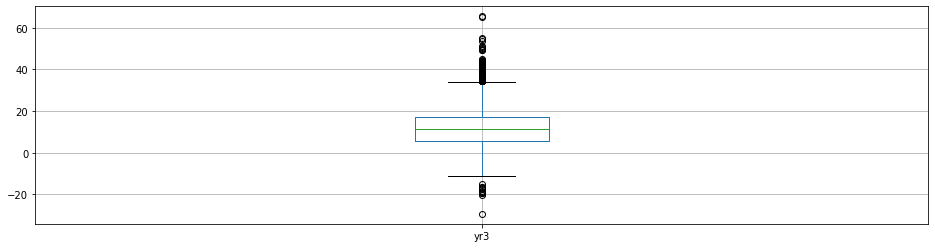

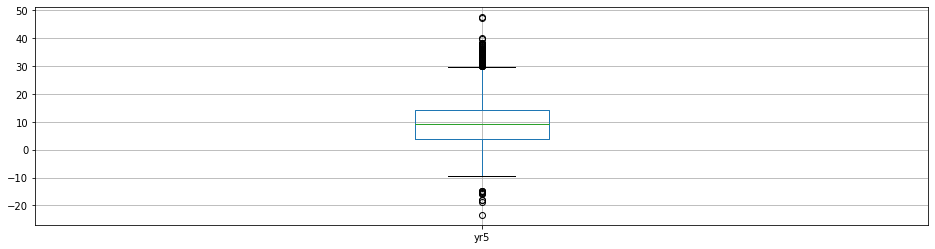

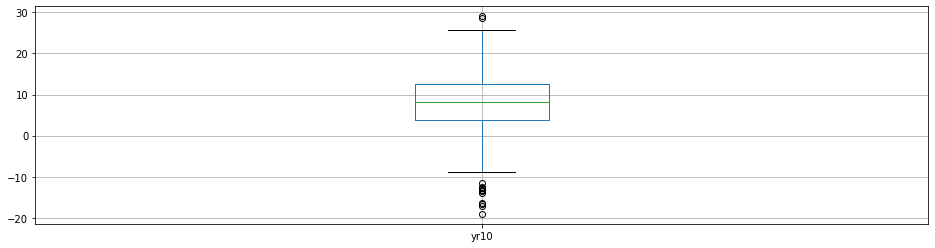

In [7]:
for column in df.columns[3:7]:
    plt.figure(figsize = (16,4))
    df.boxplot([column])

# Mean trend line

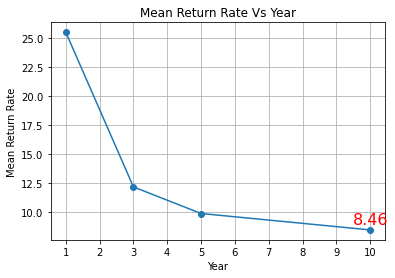

In [90]:
year = [1,3,5,10]
mean_return = [df['yr1'].mean(), df['yr3'].mean() , df['yr5'].mean(), df['yr10'].mean()]
  
plt.plot(year, mean_return, marker = 'o')
plt.grid(zorder=0)
plt.title('Mean Return Rate Vs Year')
plt.xlabel('Year')
plt.ylabel('Mean Return Rate')
plt.xticks(np.arange(min(year), max(year)+1, 1.0))
plt.annotate(round(min(mean_return),2),(max(year)-.5, min(mean_return)+.5),fontsize=16,color="red")
plt.show()

# Distribution of Risk

array([[<AxesSubplot:title={'center':'risk'}>]], dtype=object)

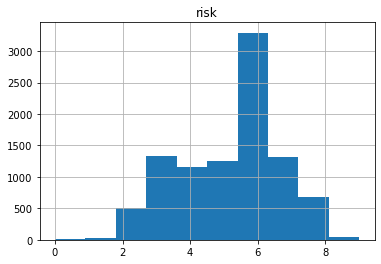

In [19]:
df.hist(column = 'risk')

# Distribution of Category

In [26]:
from collections import Counter

In [33]:
# Unique categories
df['morningstar_category'].nunique()

119

<AxesSubplot:>

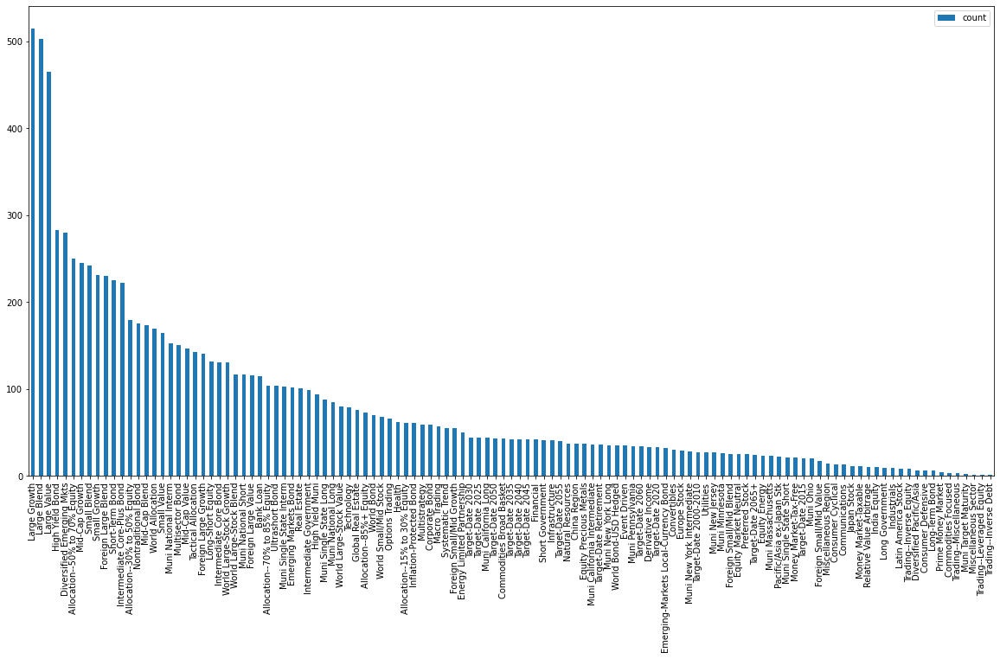

In [45]:
cat_cnt = Counter(df['morningstar_category'])
cat_cnt_df=pd.DataFrame.from_dict(cat_cnt, orient='index', columns = ['count'])
cat_cnt_df.sort_values('count', ascending= False, inplace=True)
cat_cnt_df.plot(kind='bar', figsize = (20,10))

# Distribution of minimum investments

Text(0.5, 0, 'minimum_investment')

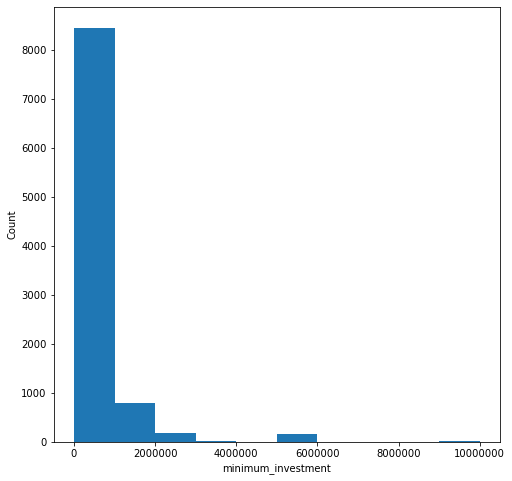

In [64]:
plt.figure(figsize=(8,8))
plt.hist(df['minimum_investment']) 
plt.ticklabel_format(axis="x", style="sci", scilimits=(0,10))
plt.ylabel('Count')
plt.xlabel('minimum_investment')

# Distribution of returns

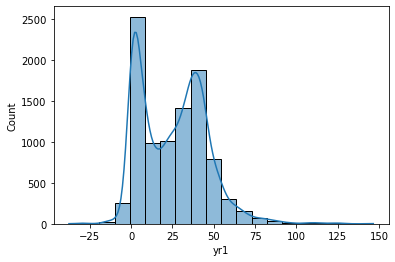

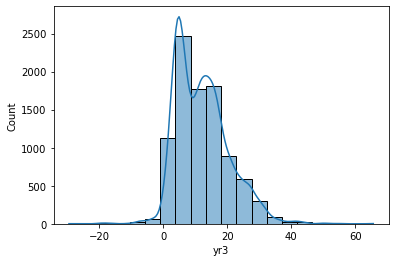

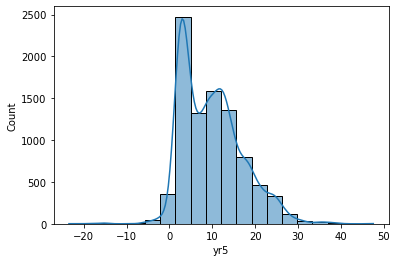

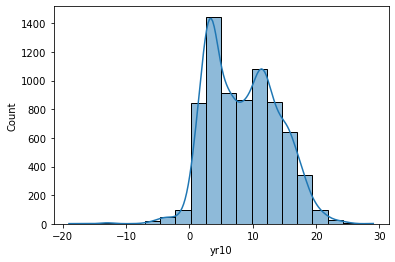

In [10]:
for column in df.columns[3:7]:
    sns.histplot(df[column], kde=True, bins=20)
    plt.show()